In [4]:
import json
import numpy as np
import cv2
from imgaug import augmenters as iaa
from imgaug.augmentables.polys import Polygon, PolygonsOnImage

dataset_dir = "/home/emir/Desktop/dev/Inovako_dataset_fully/"

def make_polys(json_file):
    with open(json_file, "r") as js:
        json_data = json.load(js)
    # print(f"json_data {json_data}")
    polys = []
    image_path = json_data['imagePath']
    for shape in json_data['shapes']:
        # This assert might be overkill but better safe that sorry ...
        assert shape['shape_type'] == "polygon"
        polys.append(Polygon(shape['points'], label=shape['label']))

    img_shape = (json_data['imageHeight'], json_data['imageWidth'], 3)
    polys_oi = PolygonsOnImage(polys, shape=img_shape)
    return(polys_oi), image_path

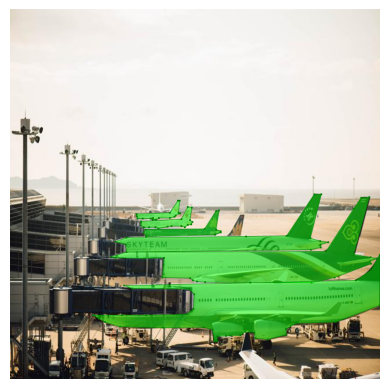

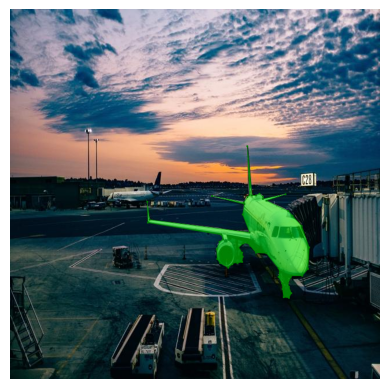

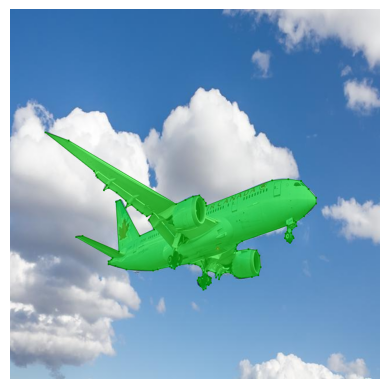

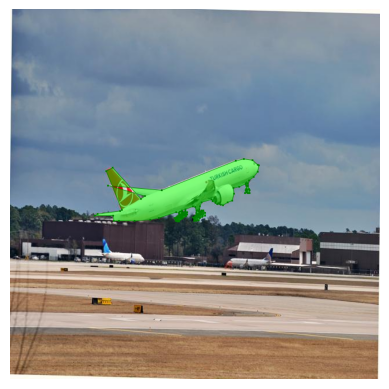

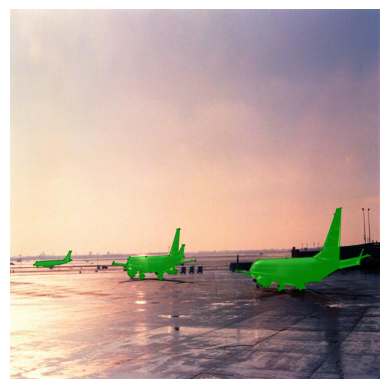

...

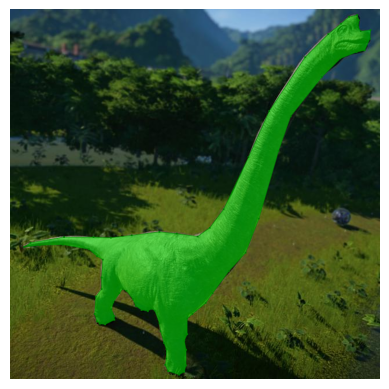

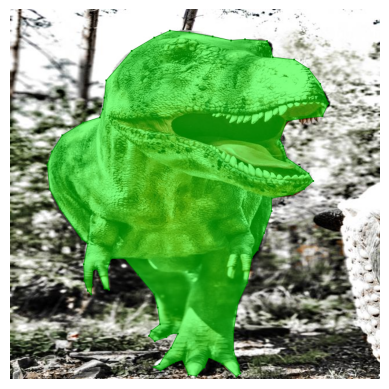

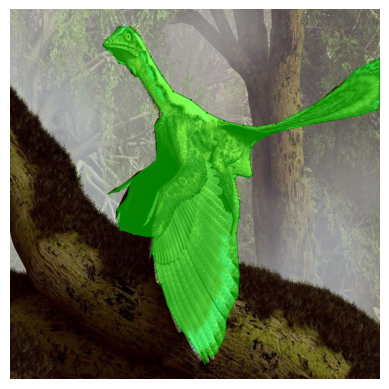

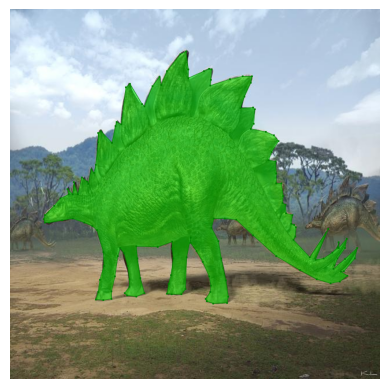

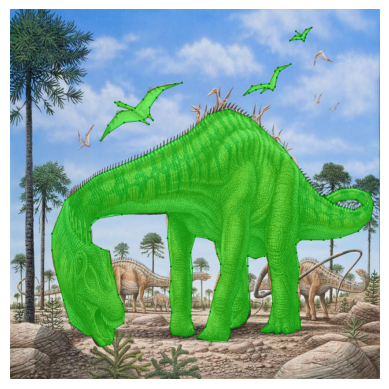

In [5]:
import os
import time
import matplotlib.pyplot as plt
classes = ["plane", "elephant", "dinosaur"]
for cls in classes:
    data_dir = dataset_dir + cls + "/"
    for dir in os.listdir(data_dir):
        if dir[-3:] == "jpg":
            img = cv2.imread(data_dir + dir)
            polys, _ = make_polys(data_dir+dir[:-3]+"json")
            output_img = polys.draw_on_image(img)
            plt.imshow(cv2.cvtColor(output_img, cv2.COLOR_BGR2RGB))
            plt.axis('off')
            plt.show()